Nama : Hero Kartiko
NIM : 1103210205
UTS Machine Learning

Library yang digunakan untuk menjalankan program

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler, StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, mean_squared_error, r2_score
from xgboost import XGBClassifier

Membaca file csv dengan pandas 

In [3]:
df = pd.read_csv('RegresiUTSTelkom.csv')
df

,2001,49.94357,21.47114,73.0775,8.74861,-17.40628,-13.09905,-25.01202,-12.23257,7.83089,...,13.0162,-54.40548,58.99367,15.37344,1.11144,-23.08793,68.40795,-1.82223,-27.46348,2.26327
0,2001,48.73215,18.42930,70.32679,12.94636,-10.32437,-24.83777,8.76630,-0.92019,18.76548,...,5.66812,-19.68073,33.04964,42.87836,-9.90378,-32.22788,70.49388,12.04941,58.43453,26.92061
1,2001,50.95714,31.85602,55.81851,13.41693,-6.57898,-18.54940,-3.27872,-2.35035,16.07017,...,3.03800,26.05866,-50.92779,10.93792,-0.07568,43.20130,-115.00698,-0.05859,39.67068,-0.66345
2,2001,48.24750,-1.89837,36.29772,2.58776,0.97170,-26.21683,5.05097,-10.34124,3.55005,...,34.57337,-171.70734,-16.96705,-46.67617,-12.51516,82.58061,-72.08993,9.90558,199.62971,18.85382
3,2001,50.97020,42.20998,67.09964,8.46791,-15.85279,-16.81409,-12.48207,-9.37636,12.63699,...,9.92661,-55.95724,64.92712,-17.72522,-1.49237,-7.50035,51.76631,7.88713,55.66926,28.74903
4,2001,50.54767,0.31568,92.35066,22.38696,-25.51870,-19.04928,20.67345,-5.19943,3.63566,...,6.59753,-50.69577,26.02574,18.94430,-0.33730,6.09352,35.18381,5.00283,-11.02257,0.02263
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
515339,2006,51.28467,45.88068,22.19582,-5.53319,-3.61835,-16.36914,2.12652,5.18160,-8.66890,...,4.81440,-3.75991,-30.92584,26.33968,-5.03390,21.86037,-142.29410,3.42901,-41.14721,-15.46052
515340,2006,49.87870,37.93125,18.65987,-3.63581,-27.75665,-18.52988,7.76108,3.56109,-2.50351,...,32.38589,-32.75535,-61.05473,56.65182,15.29965,95.88193,-10.63242,12.96552,92.11633,10.88815
515341,2006,45.12852,12.65758,-38.72018,8.80882,-29.29985,-2.28706,-18.40424,-22.28726,-4.52429,...,-18.73598,-71.15954,-123.98443,121.26989,10.89629,34.62409,-248.61020,-6.07171,53.96319,-8.09364
515342,2006,44.16614,32.38368,-3.34971,-2.49165,-19.59278,-18.67098,8.78428,4.02039,-12.01230,...,67.16763,282.77624,-4.63677,144.00125,21.62652,-29.72432,71.47198,20.32240,14.83107,39.74909


In [3]:
df.head()

,2001,49.94357,21.47114,73.0775,8.74861,-17.40628,-13.09905,-25.01202,-12.23257,7.83089,...,13.0162,-54.40548,58.99367,15.37344,1.11144,-23.08793,68.40795,-1.82223,-27.46348,2.26327
0,2001,48.73215,18.42930,70.32679,12.94636,-10.32437,-24.83777,8.76630,-0.92019,18.76548,...,5.66812,-19.68073,33.04964,42.87836,-9.90378,-32.22788,70.49388,12.04941,58.43453,26.92061
1,2001,50.95714,31.85602,55.81851,13.41693,-6.57898,-18.54940,-3.27872,-2.35035,16.07017,...,3.03800,26.05866,-50.92779,10.93792,-0.07568,43.20130,-115.00698,-0.05859,39.67068,-0.66345
2,2001,48.24750,-1.89837,36.29772,2.58776,0.97170,-26.21683,5.05097,-10.34124,3.55005,...,34.57337,-171.70734,-16.96705,-46.67617,-12.51516,82.58061,-72.08993,9.90558,199.62971,18.85382
3,2001,50.97020,42.20998,67.09964,8.46791,-15.85279,-16.81409,-12.48207,-9.37636,12.63699,...,9.92661,-55.95724,64.92712,-17.72522,-1.49237,-7.50035,51.76631,7.88713,55.66926,28.74903
4,2001,50.54767,0.31568,92.35066,22.38696,-25.51870,-19.04928,20.67345,-5.19943,3.63566,...,6.59753,-50.69577,26.02574,18.94430,-0.33730,6.09352,35.18381,5.00283,-11.02257,0.02263


In [27]:
df.info

<bound method DataFrame.info of         2001  49.94357  21.47114   73.0775   8.74861  -17.40628  -13.09905  \
0       2001  48.73215  18.42930  70.32679  12.94636  -10.32437  -24.83777   
1       2001  50.95714  31.85602  55.81851  13.41693   -6.57898  -18.54940   
2       2001  48.24750  -1.89837  36.29772   2.58776    0.97170  -26.21683   
3       2001  50.97020  42.20998  67.09964   8.46791  -15.85279  -16.81409   
4       2001  50.54767   0.31568  92.35066  22.38696  -25.51870  -19.04928   
...      ...       ...       ...       ...       ...        ...        ...   
515339  2006  51.28467  45.88068  22.19582  -5.53319   -3.61835  -16.36914   
515340  2006  49.87870  37.93125  18.65987  -3.63581  -27.75665  -18.52988   
515341  2006  45.12852  12.65758 -38.72018   8.80882  -29.29985   -2.28706   
515342  2006  44.16614  32.38368  -3.34971  -2.49165  -19.59278  -18.67098   
515343  2005  51.85726  59.11655  26.39436  -5.46030  -20.69012  -19.95528   

        -25.01202  -12.23257   

In [4]:
# Buat nama kolom
columns = ['year'] + [f'x{i}' for i in range(1, df.shape[1])]

# Update the dataset's column names
df.columns = columns

* Menyediakan struktur yang terorganisasi untuk dataset dengan nama kolom yang tidak relevan atau tidak tersedia.
* Cocok untuk standarisasi data awal sebelum melakukan eksplorasi data, analisis, atau modeling.
* Membantu menciptakan workflow analisis yang efisien, terutama ketika bekerja dengan dataset besar atau tidak terstruktur.

In [5]:
df.head()

,year,x1,x2,x3,x4,x5,x6,x7,x8,x9,...,x81,x82,x83,x84,x85,x86,x87,x88,x89,x90
0,2001,48.73215,18.42930,70.32679,12.94636,-10.32437,-24.83777,8.76630,-0.92019,18.76548,...,5.66812,-19.68073,33.04964,42.87836,-9.90378,-32.22788,70.49388,12.04941,58.43453,26.92061
1,2001,50.95714,31.85602,55.81851,13.41693,-6.57898,-18.54940,-3.27872,-2.35035,16.07017,...,3.03800,26.05866,-50.92779,10.93792,-0.07568,43.20130,-115.00698,-0.05859,39.67068,-0.66345
2,2001,48.24750,-1.89837,36.29772,2.58776,0.97170,-26.21683,5.05097,-10.34124,3.55005,...,34.57337,-171.70734,-16.96705,-46.67617,-12.51516,82.58061,-72.08993,9.90558,199.62971,18.85382
3,2001,50.97020,42.20998,67.09964,8.46791,-15.85279,-16.81409,-12.48207,-9.37636,12.63699,...,9.92661,-55.95724,64.92712,-17.72522,-1.49237,-7.50035,51.76631,7.88713,55.66926,28.74903
4,2001,50.54767,0.31568,92.35066,22.38696,-25.51870,-19.04928,20.67345,-5.19943,3.63566,...,6.59753,-50.69577,26.02574,18.94430,-0.33730,6.09352,35.18381,5.00283,-11.02257,0.02263


In [4]:
# Exploratory Data Analysis
print("Missing Values:\n", df.isnull().sum())

Missing Values:
 year    0
x1      0
x2      0
x3      0
x4      0
       ..
x86     0
x87     0
x88     0
x89     0
x90     0
Length: 91, dtype: int64


* Mengidentifikasi Missing Values:
    * Menggunakan df.isnull() untuk mendeteksi nilai-nilai hilang (NaN) dalam dataset.
    * Metode ini menghasilkan DataFrame Boolean, di mana True berarti nilai hilang dan False berarti nilai tersedia.

* Menghitung Total Missing Values:
    * Menggunakan .sum() untuk menghitung jumlah True pada setiap kolom.
    * Hasilnya adalah jumlah nilai hilang untuk setiap kolom dataset.

In [8]:
# Handle missing values
print(df.fillna(df.mean(), inplace=True))

# Remove duplicates
print(df.drop_duplicates(inplace=True))

None
None


Menganalisis apakah ada fitur yang nilainya kosong :
* Jika iya,, maka akan di drop dan diganti dengan nilai rata - rata kolom.
* Jika tidak, maka tidak akan ada yang dirubah.

In [6]:
# Melihat statistical summary dari dataset
stat_summary = df.describe()
print("\nStatistical Summary dari Dataset:")
print(stat_summary)


Statistical Summary dari Dataset:
                year             x1             x2             x3  \
count  515130.000000  515130.000000  515130.000000  515130.000000   
mean     1998.396300      43.386243       1.284453       8.658865   
std        10.931639       6.067918      51.583820      35.270798   
min      1922.000000       1.749000    -337.092500    -301.005060   
25%      1994.000000      39.953433     -26.065532     -11.463113   
50%      2002.000000      44.257105       8.412635      10.476855   
75%      2006.000000      47.833555      36.121255      29.766593   
max      2011.000000      61.970140     384.065730     322.851430   

                  x4             x5             x6             x7  \
count  515130.000000  515130.000000  515130.000000  515130.000000   
mean        1.164394      -6.553821      -9.521523      -2.391044   
std        16.322518      22.861826      12.858266      14.572838   
min      -154.183580    -181.953370     -81.794290    -188.214000  

Jumlah Data (count): Menunjukkan banyaknya data dalam setiap kolom.

Jika count lebih rendah dari total baris dataset, ada nilai yang hilang (missing values) di kolom tersebut.
Tendensi Sentral:

* mean: Rata-rata nilai di setiap kolom.
* 50%: Median atau nilai tengah.
* Jika mean dan median sangat berbeda, kemungkinan ada outlier di kolom tersebut.

Dispersi Data:

* std : Menunjukkan tingkat variasi data. Semakin tinggi nilainya, semakin menyebar data.
* min, max, dan range : Rentang antara nilai minimum dan maksimum membantu memahami skala data.
* Kuartil : 25%, 50%, 75% memberikan informasi distribusi data.
Jika rentang antar kuartil (IQR: 75% - 25%) sangat besar, distribusi data cenderung menyebar.

Outlier:

Periksa kolom dengan nilai min atau max yang jauh dari kuartil (25% atau 75%), karena ini menunjukkan adanya outlier.

Penjelasan Fitur
year:

* Mean: 1998, menunjukkan mayoritas data berasal dari sekitar akhir 1990-an.
* Range: Dari 1922 hingga 2011, menandakan cakupan data lebih dari 80 tahun.
* Distribusi: Median (2002) lebih besar dari mean (1998), menunjukkan distribusi sedikit miring ke kiri (lebih banyak data di tahun-tahun awal).

x1 hingga x9 (dan seterusnya):
* Rentang: Setiap fitur memiliki skala yang berbeda:
* x2: Sangat luas, dengan nilai dari -337 hingga 384.
* x7: Berfluktuasi antara -188 dan 172, menunjukkan outlier yang mungkin.

Distribusi:
* Mean beberapa fitur mendekati 0 (seperti x4, x5), yang menunjukkan nilai-nilai tersebar secara simetris di sekitar nol.
* Fitur seperti x8 dan x9 memiliki nilai maksimum jauh lebih besar dari kuartil atas (75%), menunjukkan keberadaan outlier.

Standard Deviation (Std):
* Fitur seperti x2, x3, dan x8 memiliki standar deviasi yang sangat besar dibandingkan mean, menunjukkan bahwa nilai-nilai dalam fitur ini sangat tersebar dan memiliki rentang yang luas.
* Fitur dengan std besar (misalnya, x81, x82) mungkin membutuhkan transformasi data untuk meningkatkan performa model.


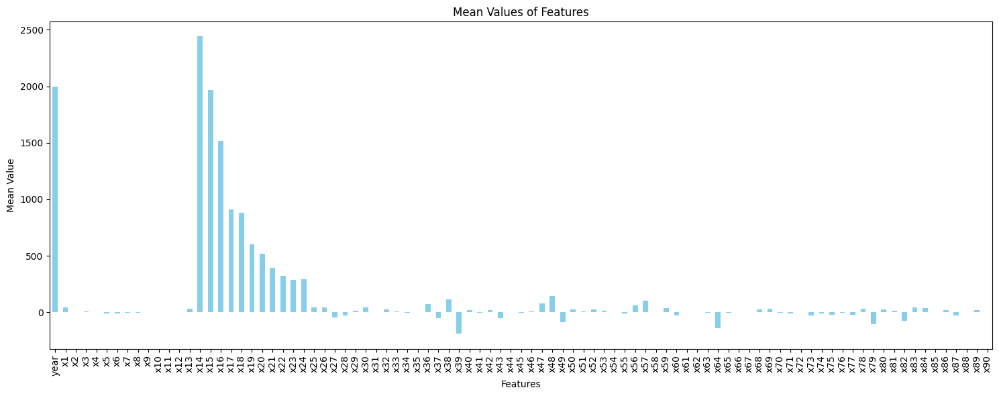

In [33]:
# 1. Distribution of Feature Means
feature_means = df.mean()

plt.figure(figsize=(15, 6))
feature_means.plot(kind='bar', color='skyblue')
plt.title('Mean Values of Features')
plt.xlabel('Features')
plt.ylabel('Mean Value')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()


1. Skala dan Pola Distribusi:
    * Visualisasi menunjukkan rata-rata nilai setiap fitur dalam dataset.
    * Fitur dengan nilai rata-rata lebih tinggi (seperti x12, x13, dan x14 dalam gambar) mungkin memiliki skala yang berbeda dari fitur lainnya.
    * Fitur dengan rata-rata mendekati nol (seperti x2, x3, dst.) mungkin menunjukkan data yang terskala atau memiliki distribusi mendekati nol.

2. Perbandingan Antar-Fitur:
    * Visualisasi membantu mengidentifikasi fitur yang memiliki pola dominan atau skala jauh lebih besar dibandingkan fitur lainnya. Fitur dengan skala jauh lebih besar mungkin perlu distandarisasi sebelum analisis lebih lanjut.

3. Pentingnya Standarisasi:
    * Jika fitur memiliki skala yang sangat berbeda, seperti pada visualisasi ini, standarisasi (menggunakan StandardScaler) dapat membantu memastikan bahwa semua fitur diperlakukan secara setara dalam analisis atau modeling.

4. Indikasi Data Tidak Seimbang:
    * Fitur yang memiliki rata-rata jauh lebih tinggi atau lebih rendah dapat menunjukkan ketidakseimbangan data atau anomali dalam pengumpulan data.

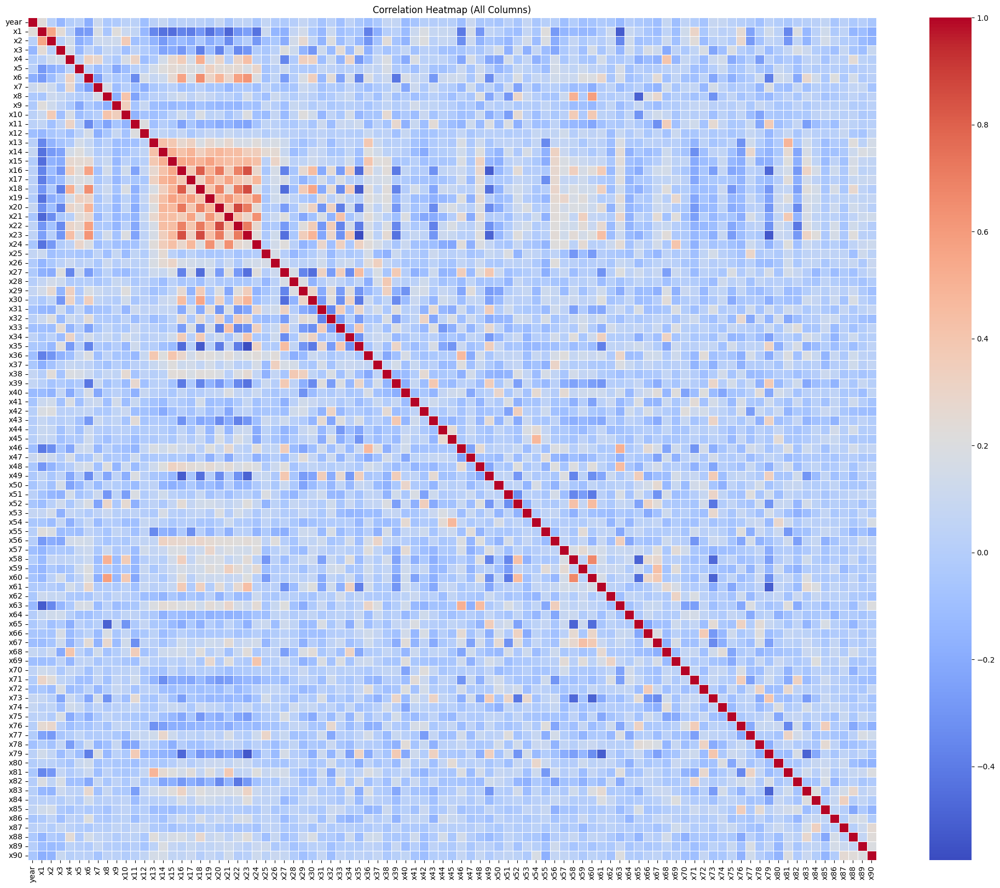

In [34]:
# Compute the correlation matrix for all columns
corr_matrix_full = df.corr()

# Create the heatmap for all columns
plt.figure(figsize=(25, 20))
sns.heatmap(corr_matrix_full, annot=False, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap (All Columns)')
plt.show()

1. Korelasi Tinggi Positif (warna merah terang):
    * Kolom-kolom dengan hubungan positif yang kuat menunjukkan bahwa ketika satu kolom meningkat, kolom lain cenderung meningkat pula.
    * Misalnya, dalam heatmap, beberapa kolom seperti x12, x13, dan x14 mungkin memiliki korelasi tinggi satu sama lain.
2. Korelasi Tinggi Negatif (warna biru terang):
    * Hubungan negatif menunjukkan bahwa ketika satu kolom meningkat, kolom lain cenderung menurun.
    * Kolom yang berwarna biru terang dalam heatmap mengindikasikan hubungan semacam ini.
3. Tidak Ada Korelasi (warna putih atau mendekati putih):
    * Hubungan lemah atau tidak ada hubungan linear antara dua kolom.
4. Hubungan Multikolinearitas:
    * Jika beberapa kolom memiliki korelasi sangat tinggi (mendekati +1 atau -1), ada risiko multikolinearitas, yang dapat memengaruhi performa model machine learning.
    * Kolom yang sangat berkorelasi dapat dipertimbangkan untuk dihapus atau diubah menjadi fitur baru (misalnya, menggunakan PCA).

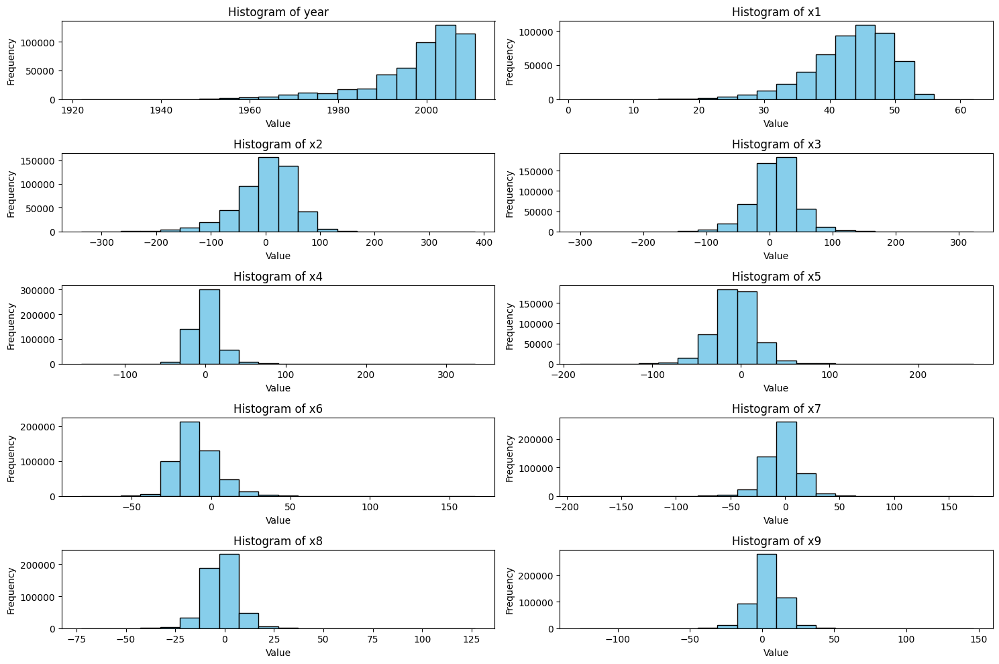

In [35]:
# Select a subset of columns (e.g., first 10)
selected_columns = df.columns[:10]

# Plot histograms for the selected features
plt.figure(figsize=(15, 10))
for i, column in enumerate(selected_columns, 1):
    plt.subplot(5, 2, i)  # Create a 5x2 grid for histograms
    plt.hist(df[column], bins=20, color='skyblue', edgecolor='black')
    plt.title(f'Histogram of {column}')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
plt.tight_layout()
plt.show()

1. Distribusi Data:
    * Kolom dengan distribusi normal:
        * Kolom seperti x1, x3, x5, dan x7 menunjukkan pola distribusi mendekati normal (simetris).
    * Kolom dengan distribusi miring:
        * Kolom seperti year menunjukkan distribusi yang miring ke kanan, dengan nilai sebagian besar terkonsentrasi di rentang tertentu.

2. Outlier:
    * Pada beberapa kolom, terdapat nilai yang jauh di ujung (misalnya pada x2 dan x4), yang dapat menjadi outlier.
    * Outlier dapat memengaruhi performa model machine learning, sehingga perlu penanganan khusus (misalnya, scaling, imputasi, atau penghapusan).
3. Skala Berbeda Antar Kolom:
    * Histogram menunjukkan bahwa kolom seperti year memiliki nilai jauh lebih besar dibandingkan kolom lainnya. Hal ini menandakan perlunya standarisasi atau normalisasi sebelum modeling.

In [36]:
# Pair plot for a subset (e.g., first 10 features)
subset_df = df.iloc[:, :20]

sns.pairplot(subset_df.iloc[:1000], diag_kind='kde')  # Limited to 1000 rows for performance
plt.suptitle('Scatter Matrix for First 20 Features', y=1.02)
plt.show()


1. Korelasi Antar Fitur:
    * Hubungan linier yang jelas antara beberapa fitur menunjukkan korelasi positif atau negatif. Hal ini bisa dikonfirmasi lebih lanjut dengan matriks korelasi.
    * Korelasi tinggi antar fitur dapat menyebabkan multikolinearitas dalam model dan perlu ditangani.
2. Distribusi Fitur:
    * Distribusi fitur memberikan wawasan tentang skala data, keberadaan outlier, dan kebutuhan transformasi (misalnya, log transform untuk fitur dengan distribusi miring).
3. Cluster atau Pola Tersembunyi:
    * Scatter plot yang menunjukkan grup titik dapat menunjukkan cluster atau hubungan non-linier antara fitur.
4. Outlier:
    * Kehadiran outlier dapat memengaruhi performa model dan perlu ditangani melalui teknik seperti penghapusan atau imputasi.


## Split Data

In [5]:
# Memisahkan dataset menjadi fitur (X) dan target (y)
X = df.drop(columns=['year'])
y = df['year']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

1. Pentingnya Memisahkan Fitur dan Target
    * Memisahkan fitur dan target adalah langkah penting dalam modeling:
        * Fitur (X) digunakan sebagai input.
        * Target (y) digunakan untuk menentukan hasil yang akan diprediksi.
    * Dalam dataset ini, kolom 'year' dipilih sebagai target karena mungkin dianggap sebagai label yang ingin diprediksi.
2. Training dan Testing
    * Membagi dataset menjadi data training dan testing adalah langkah penting untuk:
        * Melatih model dengan data training.
        * Menguji generalisasi model menggunakan data testing yang belum pernah dilihat model.
    * Proporsi 80%-20% adalah umum digunakan untuk membagi data, tetapi bisa disesuaikan (misalnya, 70%-30% untuk dataset kecil).
3. Menggunakan random_state
    * Menentukan random_state memastikan bahwa pembagian data tetap konsisten setiap kali kode dijalankan, yang memudahkan replikasi eksperimen.
4. Ukuran Data Training dan Testing
    * Jika dataset terlalu kecil, alokasikan lebih banyak data untuk training (misalnya, 90%-10%) agar model mendapatkan cukup data untuk belajar.
    * Jika dataset besar, proporsi 80%-20% biasanya sudah cukup.

## Scaling

In [6]:
# Initialize the scaler
scaler = StandardScaler()

# Sample 10,000 rows from the training data for hyperparameter tuning
X_train_sample = X_train.sample(n=10000, random_state=42)
y_train_sample = y_train[X_train_sample.index]

1. Sampel diambil karena :
    * Jika dataset sangat besar, menggunakan seluruh data untuk hyperparameter tuning atau pelatihan dapat memakan waktu dan sumber daya yang signifikan.
    * Dengan mengambil sampel yang cukup besar (misalnya, 10.000 baris), Anda dapat mempercepat proses tanpa kehilangan banyak informasi dari data.
2. Penggunaan random_state:
    * Menentukan random_state memastikan bahwa sampel yang diambil tetap konsisten setiap kali kode dijalankan, yang penting untuk reproduktifitas eksperimen.
3. Keseimbangan Data:
    * Sampling ini tidak memperhatikan distribusi kelas. Jika data tidak seimbang, ada risiko distribusi kelas dalam sampel tidak mewakili data asli. Hal ini dapat memengaruhi performa model atau hyperparameter tuning.
4. Standarisasi Fitur:
    * StandardScaler diinisialisasi tetapi belum diterapkan. Biasanya, ini diterapkan setelah sampling untuk memastikan semua fitur memiliki skala yang seragam sebelum masuk ke proses machine learning.


# Basis Function

In [ ]:
# Pipeline
pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Standardize features
    ('poly', PolynomialFeatures(include_bias=False, degree=1)),  # Batasi hanya linear
    ('model', LogisticRegression(max_iter=1000, random_state=42, solver='saga'))  # Solver lebih cepat
])

Kombinasi Basis Function + Logistic Regression:
* Kombinasi ini membuat Polynomial menjadi lebih fleksibel, mampu menangkap hubungan non-linear dalam dataset.

Peluang Optimasi:
* Melakukan tuning pada hyperparameter seperti degree polinomial dan regularization strength (C) untuk menemukan keseimbangan antara akurasi dan kompleksitas.

Rekomendasi:
* Awasi performa model pada data testing untuk mendeteksi potensi overfitting, terutama jika degree polinomial terlalu tinggi.

In [14]:
# Define parameter grid for hypertuning
param_distributions = {
    'poly__degree': [1, 2, 3],  # Restrict polynomial degree to avoid too many features
    'model__C': [0.1, 1.0],  # Reduce number of options for regularization strength
    'model__solver': ['lbfgs'],  # Use a single solver to save computation
}

# Use a smaller downsample size
X_train_sample, y_train_sample = X_train.sample(n=10000, random_state=42), y_train.sample(n=10000, random_state=30)

1. Mengontrol Kompleksitas Model dengan C:
    * Parameter regulasi C memungkinkan Anda menyesuaikan kompleksitas model:
        * C kecil untuk menghindari overfitting.
        * C besar untuk fleksibilitas lebih tinggi.
    * Parameter C membantu mencegah overfitting, terutama jika dataset kecil atau memiliki fitur yang tidak relevan..
2. Menggunakan Solver yang Sesuai:
    * Solver liblinear dan lbfgs dipilih karena keduanya cocok untuk Logistic Regression.
    * Solver liblinear lebih cocok untuk dataset kecil, sedangkan lbfgs lebih efisien untuk dataset besar.

In [15]:
random_search = RandomizedSearchCV(
    pipeline,
    param_distributions=param_distributions,
    n_iter=len(param_distributions['poly__degree']) * len(param_distributions['model__C']) * len(param_distributions['model__solver']),
    cv=3,  # Tidak ada cross-validation
    scoring='accuracy',
    n_jobs=-1,
    verbose=0,
    random_state=42
)

Hyperparameter Tuning:
* Kode ini menjelajahi 10 kombinasi acak dari parameter (n_iter=10) yang didefinisikan di param_distributions.
* Berbeda dengan GridSearchCV, yang mencoba semua kombinasi, RandomizedSearchCV lebih efisien untuk ruang parameter yang besar karena hanya menjelajahi subsetnya secara acak.
* Menggunakan RandomizedSearchCV karena tidak perlu mencoba semua kombinasi seperti GridSearchCV sehingga waktu yang diperlukan cukup sedikit.

Cross-Validation:
* 3-fold cross-validation (cv=3) digunakan untuk mengevaluasi setiap kombinasi parameter.
* Membagi data menjadi tiga lipatan, di mana dua lipatan digunakan untuk pelatihan dan satu lipatan untuk validasi secara bergantian, memastikan evaluasi yang lebih robust.

Evaluasi Model:
* Scoring berdasarkan accuracy memastikan bahwa kombinasi parameter terbaik dipilih berdasarkan akurasi prediksi pada data validasi.

Efisiensi:
* Menggunakan n_jobs=-1 memanfaatkan semua core CPU untuk mempercepat proses tuning.
* random_state=42 memastikan hasil acak konsisten dan dapat direplikasi.

Output Akhir:
* Kombinasi parameter terbaik dan skor akurasi terbaik akan disimpan dalam atribut best_params_ dan best_score_ setelah fitting.

In [11]:
# Fit the model with the smaller dataset
random_search.fit(X_train_sample, y_train_sample)

Fitting 2 folds for each of 4 candidates, totalling 8 fits


c:\Users\NITRO 5\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=2.
  warnings.warn(


RandomizedSearchCV(cv=2,
                   estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                             ('poly',
                                              PolynomialFeatures(degree=1,
                                                                 include_bias=False)),
                                             ('model',
                                              LogisticRegression(max_iter=500,
                                                                 random_state=42,
                                                                 solver='saga'))]),
                   n_iter=4, n_jobs=-1,
                   param_distributions={'model__C': [0.1, 1.0],
                                        'model__solver': ['lbfgs'],
                                        'poly__degree': [1, 2]},
                   random_state=42, scoring='accuracy', verbose=1)

* Random Downsampling : 
    *  40% data dipilih sebagai data training
    * Mengurangi waktu komputasi pada dataset besar.
    * Cocok untuk eksperimen awal atau ketika sumber daya komputasi terbatas.
    * Jika data tidak seimbang, pengambilan acak tanpa stratifikasi dapat menghasilkan subset yang tidak representatif, sehingga memengaruhi performa model.




Top 5 Hyperparameter Combinations:
   mean_test_score  std_test_score  \
0           0.0619          0.0023   
1           0.0568          0.0018   
3           0.0560          0.0004   
2           0.0538          0.0010   

                                              params  
0  {'poly__degree': 1, 'model__solver': 'lbfgs', ...  
1  {'poly__degree': 2, 'model__solver': 'lbfgs', ...  
3  {'poly__degree': 2, 'model__solver': 'lbfgs', ...  
2  {'poly__degree': 1, 'model__solver': 'lbfgs', ...  


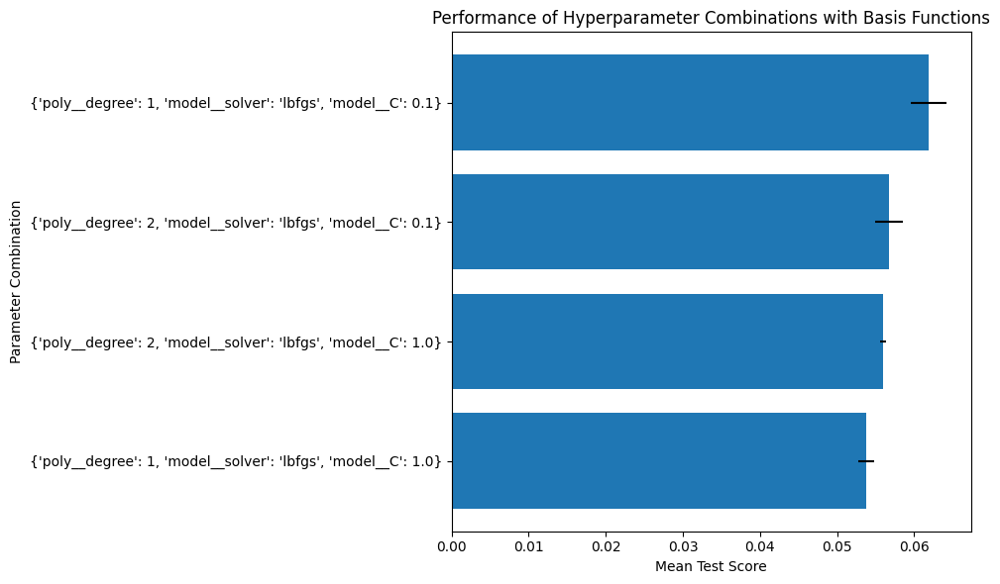


Best Hyperparameters: {'poly__degree': 1, 'model__solver': 'lbfgs', 'model__C': 0.1}
Best Accuracy Score: 0.0619


In [13]:
# Extract the results from RandomizedSearchCV
results = pd.DataFrame(random_search.cv_results_)

# Sort results by mean test score (descending order)
results = results.sort_values(by='mean_test_score', ascending=False)

# Display the top 5 parameter combinations and their scores
print("\nTop 5 Hyperparameter Combinations:")
print(results[['mean_test_score', 'std_test_score', 'params']].head(5))

# Plot Mean Test Scores for Each Combination
plt.figure(figsize=(10, 6))
plt.barh(
    results['params'].apply(str).head(10),
    results['mean_test_score'].head(10),
    xerr=results['std_test_score'].head(10),
    align='center'
)
plt.xlabel('Mean Test Score')
plt.ylabel('Parameter Combination')
plt.title('Performance of Hyperparameter Combinations with Basis Functions')
plt.gca().invert_yaxis()  # Best score at the top
plt.tight_layout()
plt.show()

# Report the best hyperparameters and score
print("\nBest Hyperparameters:", random_search.best_params_)
print("Best Accuracy Score:", random_search.best_score_)


1. Hyperparameter yang Signifikan
* Hyperparameter seperti subsample, reg_lambda, max_depth, dan learning_rate memiliki peran besar dalam memengaruhi performa model:
    * subsample=0.6:
        * Meningkatkan generalisasi dengan mengurangi data yang digunakan setiap pohon.
    * max_depth=7:
        * Membatasi kedalaman pohon untuk mencegah overfitting.
    * learning_rate=0.2:
        * Tingkat pembelajaran moderat memungkinkan model belajar lebih cepat tanpa kehilangan performa.
2. Regularisasi Membantu Generalisasi
    * reg_lambda=1 (L2) dan reg_alpha=0.1 (L1):
        * Membantu mencegah overfitting dengan menekan kompleksitas model, terutama untuk dataset besar atau fitur yang tidak relevan.
3. Penjelasan Kombinasi : 
    * subsample=0.6:
        Hanya 60% data sampel yang digunakan untuk setiap pohon, yang membantu mencegah overfitting.
    * reg_lambda=1:
        Regularisasi L2 digunakan untuk mencegah overfitting.
    * reg_alpha=0.1:
        Regularisasi L1 membantu mengurangi bobot fitur yang kurang penting.
    * n_estimators=200:
        Menggunakan 200 pohon dalam model ensemble.
    * max_depth=7:
        Pohon dalam ensemble memiliki kedalaman maksimum 7, yang menyeimbangkan antara kompleksitas model dan generalisasi.
    * learning_rate=0.2:
        Tingkat pembelajaran yang relatif tinggi, memungkinkan model untuk konvergen lebih cepat.
    * colsample_bytree=1.0:
        Menggunakan semua fitur untuk setiap pohon.

## Decision Tree

In [ ]:
from sklearn.tree import DecisionTreeClassifier

# Define the pipeline
pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Standardize features
    ('model', DecisionTreeClassifier(random_state=42))  # Decision Tree Classifier
])


* Pipeline:
    * Kode ini menggunakan Pipeline untuk mengintegrasikan StandardScaler (untuk standarisasi fitur) dengan DecisionTreeClassifier.
* Parameter Grid:
    * Kompleksitas model (melalui max_depth, min_samples_split, dan min_samples_leaf).
    * Cara pemisahan node (melalui criterion).
    * Menyediakan fleksibilitas untuk menyeimbangkan trade-off antara overfitting dan underfitting.
* Parameter seperti max_depth dan min_samples_split mengontrol overfitting, membuat model lebih sederhana dan lebih mudah digeneralisasi.
* Pemilihan kriteria (gini vs. entropy) tergantung pada distribusi dataset; entropy mungkin lebih baik untuk dataset dengan banyak ketidakseimbangan informasi.

In [124]:
# Define parameter grid for Decision Tree
param_distributions = {
    'model__max_depth': [3, 5, 10, None],  # Depth of the tree
    'model__min_samples_split': [2, 5, 10],  # Minimum samples required to split a node
    'model__min_samples_leaf': [1, 2, 4],  # Minimum samples required in a leaf
    'model__criterion': ['gini', 'entropy'],  # Splitting criteria
}

Komponen Parameter Grid
* model__max_depth: [3, 5, 10, None]
    * Definisi: Kedalaman maksimum pohon keputusan.
    * Tujuan:
        * Membatasi kedalaman pohon untuk mengontrol kompleksitas model.
        * Nilai None memungkinkan pohon tumbuh hingga semua node menjadi murni (pure).
    * Efek:
        * Kecil (misalnya, 3): Menghindari overfitting dengan membuat pohon lebih sederhana.
        * Besar atau None: Memungkinkan pembagian mendetail, tetapi berisiko overfitting.

* model__min_samples_split: [2, 5, 10]
    * Definisi: Jumlah minimum sampel yang diperlukan untuk membagi sebuah node.
    * Tujuan:
        * Mengatur kapan sebuah node akan dibagi menjadi dua cabang.
    * Efek:
        * Nilai kecil (misalnya, 2): Membagi lebih sering, berisiko overfitting.
        * Nilai besar (misalnya, 10): Membatasi pembagian, membantu mencegah overfitting.

* model__min_samples_leaf: [1, 2, 4]
    * Definisi: Jumlah minimum sampel yang harus ada di setiap leaf node.
    * Tujuan:
        * Mengontrol ukuran minimum leaf node untuk menghindari pembagian yang terlalu spesifik.
    * Efek:
        * Nilai kecil (1): Pohon lebih kompleks, berisiko overfitting.
        * Nilai besar (4): Pohon lebih sederhana, membantu generalisasi.

* model__criterion: ['gini', 'entropy']
    * Definisi: Kriteria pemisahan node.
    * Tujuan:
        * Menentukan cara mengukur kualitas pemisahan data di node.
    * Pilihan:
        * gini: Menggunakan Gini Impurity untuk mengukur homogenitas data.
        * entropy: Menggunakan Information Gain, biasanya lebih berat secara komputasi tetapi terkadang lebih akurat.

In [125]:
# Perform RandomizedSearchCV
random_search = RandomizedSearchCV(
    pipeline,
    param_distributions=param_distributions,
    n_iter=10,  # Number of random combinations
    cv=3,  # Cross-validation folds
    scoring='accuracy',
    n_jobs=-1,  # Use all available CPU cores
    verbose=1,
    random_state=42
)

Kesimpulan

Penggunaan RandomizedSearchCV:
RandomizedSearchCV digunakan untuk hyperparameter tuning dengan mencoba 10 kombinasi parameter acak dari ruang parameter (n_iter=10).

Efisiensi Komputasi:
Semua core CPU digunakan (n_jobs=-1) untuk mempercepat proses tuning, sehingga sangat efisien untuk dataset besar.

Cross-Validation (CV):
Tuning dilakukan menggunakan 3-fold cross-validation, yang memastikan hasil evaluasi robust dan mengurangi bias pembagian data.

Scoring:
Metrik evaluasi yang digunakan adalah akurasi, yang menunjukkan seberapa baik model memprediksi kelas pada data validasi.

Reproduktivitas:
Dengan random_state=42, hasil acak konsisten di setiap eksekusi, memudahkan eksperimen untuk direplikasi.

In [126]:
# Random downsampling (without stratification)
X_downsample, _, y_downsample, _ = train_test_split(
    X_train, y_train, test_size=0.3, random_state=42
)

# Fit the model
random_search.fit(X_downsample, y_downsample)

Fitting 3 folds for each of 10 candidates, totalling 30 fits


c:\Users\NITRO 5\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_split.py:776: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


RandomizedSearchCV(cv=3,
                   estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                             ('model',
                                              DecisionTreeClassifier(random_state=42))]),
                   n_jobs=-1,
                   param_distributions={'model__criterion': ['gini', 'entropy'],
                                        'model__max_depth': [3, 5, 10, None],
                                        'model__min_samples_leaf': [1, 2, 4],
                                        'model__min_samples_split': [2, 5, 10]},
                   random_state=42, scoring='accuracy', verbose=1)

Kesimpulan
Random Downsampling:
Data training (X_train dan y_train) di-downsampling sehingga hanya 30% dari data yang digunakan sebagai subset untuk pelatihan. Sisa 70% data tidak digunakan.
Tanpa stratifikasi:
Pengambilan data dilakukan secara acak tanpa mempertahankan distribusi target (kelas) dari data asli.

Hyperparameter Tuning:
Model dilatih menggunakan subset data hasil downsampling melalui random_search, yang sebelumnya telah disiapkan dengan RandomizedSearchCV.
Dengan menggunakan subset, proses tuning menjadi lebih cepat dibandingkan menggunakan seluruh dataset.

Efisiensi Komputasi:
Downsampling mengurangi ukuran data yang digunakan, sehingga mempercepat fitting model, terutama untuk dataset besar. Namun, ini mungkin mengorbankan keakuratan representasi data asli jika data tidak seimbang.

Top 5 Hyperparameter Combinations:
   mean_test_score  std_test_score  \
6         0.079313        0.000581   
8         0.079313        0.000581   
2         0.079288        0.000812   
5         0.078817        0.000298   
0         0.077514        0.000214   

                                              params  
6  {'model__min_samples_split': 5, 'model__min_sa...  
8  {'model__min_samples_split': 2, 'model__min_sa...  
2  {'model__min_samples_split': 2, 'model__min_sa...  
5  {'model__min_samples_split': 10, 'model__min_s...  
0  {'model__min_samples_split': 5, 'model__min_sa...  


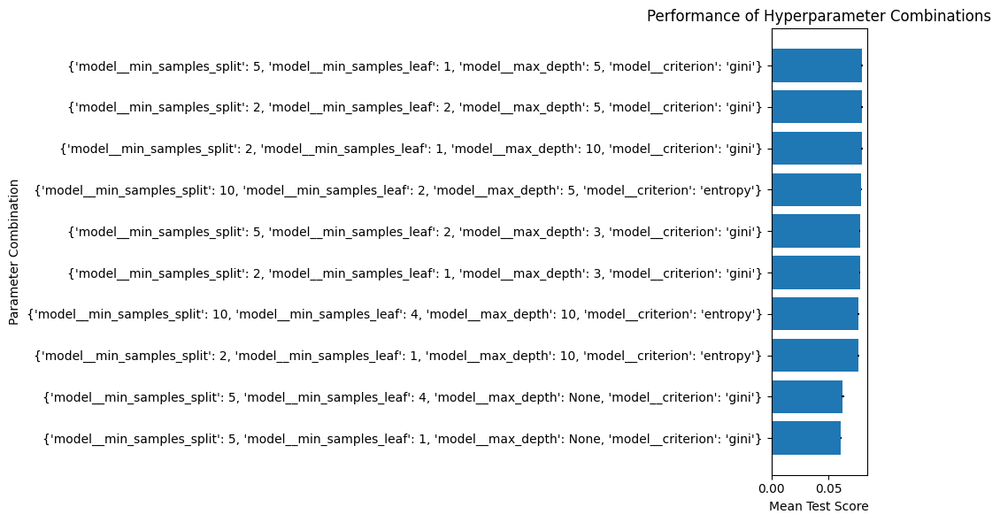

Best Hyperparameters: {'model__min_samples_split': 5, 'model__min_samples_leaf': 1, 'model__max_depth': 5, 'model__criterion': 'gini'}
Best Accuracy Score: 0.07931266284957504


In [127]:
# Extract the results from RandomizedSearchCV
results = pd.DataFrame(random_search.cv_results_)

# Sort results by mean test score (descending order)
results = results.sort_values(by='mean_test_score', ascending=False)

# Display the top 5 parameter combinations and their scores
print("Top 5 Hyperparameter Combinations:")
print(results[['mean_test_score', 'std_test_score', 'params']].head(5))

# Plot Mean Test Scores for Each Combination
plt.figure(figsize=(10, 6))
plt.barh(
    results['params'].apply(str),
    results['mean_test_score'],
    xerr=results['std_test_score'],
    align='center'
)
plt.xlabel('Mean Test Score')
plt.ylabel('Parameter Combination')
plt.title('Performance of Hyperparameter Combinations')
plt.gca().invert_yaxis()  # Best score at the top
plt.tight_layout()
plt.show()

# Report the best hyperparameters and score
print("Best Hyperparameters:", random_search.best_params_)
print("Best Accuracy Score:", random_search.best_score_)

Hyperparameter Terbaik:

Kombinasi parameter terbaik berdasarkan hasil tuning : 
* min_samples_split=5: Node hanya akan dibagi jika memiliki setidaknya 5 sampel.
* min_samples_leaf=1: Node daun harus memiliki minimal 1 sampel.
* max_depth=5: Kedalaman pohon dibatasi hingga 5 tingkat untuk mencegah overfitting.
* criterion=gini: Gini Impurity digunakan untuk memutuskan pemisahan node.

Skor Akurasi:
* Skor terbaik (mean test score): 0.0793.
* Std test score rendah (0.0005) menunjukkan hasil tuning stabil, meskipun akurasi keseluruhan masih rendah.

Top 5 Kombinasi Hyperparameter:
* Kombinasi dengan skor terbaik semuanya memiliki kedalaman maksimum pohon (max_depth) yang terbatas dan pemisahan minimal sampel (min_samples_split dan min_samples_leaf) yang masuk akal untuk mengontrol overfitting.

* Insight

Kinerja Model:

Akurasi yang rendah (0.0793) mungkin menunjukkan:
* Dataset sangat kompleks, atau model Decision Tree tidak cukup kuat untuk menangkap pola yang ada.
* Fitur yang tersedia kurang representatif untuk memisahkan kelas dengan baik.

Peran Regularisasi:
* Hyperparameter seperti max_depth=5, min_samples_split=5, dan min_samples_leaf=1 membantu mengontrol overfitting, membuat model lebih sederhana dan generalisasi lebih baik.

Pemilihan Kriteria (Gini vs. Entropy):
* Kombinasi terbaik menggunakan Gini Impurity, yang biasanya lebih cepat dan memberikan hasil setara atau lebih baik dibandingkan entropy pada dataset tertentu.

Ketergantungan pada Dataset:
* Keberhasilan Decision Tree bergantung pada kualitas dan distribusi dataset. Jika dataset besar dan kompleks, model yang lebih canggih seperti Random Forest atau Gradient Boosting mungkin lebih sesuai.

## K-NN

In [107]:
from sklearn.neighbors import KNeighborsClassifier

# Definisikan pipeline
pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Standarisasi fitur
    ('model', KNeighborsClassifier())  # K-Nearest Neighbors Classifier
])

Kesimpulan

Pipeline untuk KNN:
* Pipeline ini menggabungkan standarisasi fitur menggunakan StandardScaler dan model K-Nearest Neighbors (KNN) untuk klasifikasi.
* KNN sensitif terhadap skala data, sehingga standarisasi memastikan semua fitur memiliki skala yang sama, mencegah fitur dengan rentang besar mendominasi perhitungan jarak.

Sederhana dan Efisien:
* KNN adalah model yang sederhana dan non-parametrik. Pipeline ini cocok untuk memproses data secara efisien sebelum diterapkan ke model.

Insight

Pentingnya Standarisasi:
* KNN menghitung jarak antar titik data (misalnya, jarak Euclidean), sehingga fitur dengan skala besar dapat mendistorsi hasil jika tidak distandarisasi.
* StandardScaler adalah langkah wajib dalam pipeline ini.

Kelebihan KNN:
* Cocok untuk dataset dengan pola sederhana dan ukuran kecil hingga sedang.
* Tidak membutuhkan pelatihan kompleks karena hanya mengingat data training (lazy learning).

Kelemahan KNN:
* Komputasi lambat pada dataset besar, karena jarak dihitung untuk setiap titik data saat prediksi.
* Rentan terhadap noise dan fitur yang tidak relevan, yang dapat memengaruhi akurasi.

Parameter Penting untuk Tuning:
* n_neighbors: Jumlah tetangga yang digunakan untuk prediksi (biasanya bernilai ganjil).
* weights: Memberikan bobot berbeda ke tetangga berdasarkan jarak.
* metric: Jenis metrik untuk menghitung jarak (default adalah Euclidean).

In [108]:
# Definisikan parameter grid untuk KNN
param_distributions = {
    'model__n_neighbors': [3, 5, 7, 9, 11],  # Jumlah tetangga
    'model__weights': ['uniform', 'distance'],  # Bobot
    'model__metric': ['euclidean', 'manhattan', 'minkowski'],  # Metrik jarak
}

Kesimpulan Parameter Grid untuk KNN:

n_neighbors:
* Jumlah tetangga yang dipertimbangkan untuk prediksi, memengaruhi keseimbangan antara bias dan varians.
* Nilai kecil (misalnya, 3) cenderung menghasilkan model yang lebih variatif, sedangkan nilai besar (misalnya, 11) cenderung lebih stabil.
weights:
* uniform: Semua tetangga diberi bobot yang sama.
* distance: Tetangga lebih dekat diberi bobot lebih besar, yang sering kali meningkatkan performa pada dataset dengan pola lokal.
metric:
* Metrik jarak untuk menentukan tetangga terdekat, seperti Euclidean (standar), Manhattan (L1), atau Minkowski (generalisasi dari Euclidean dan Manhattan).


Insight

Pengaruh Jumlah Tetangga (n_neighbors):
* Nilai kecil: Model lebih responsif terhadap perubahan lokal dalam data, tetapi berisiko overfitting.
* Nilai besar: Model lebih stabil tetapi mungkin gagal menangkap pola detail.

Pentingnya weights:
* uniform cocok untuk data dengan distribusi kelas yang seragam.
* distance lebih efektif untuk data dengan pola lokal karena mempertimbangkan kedekatan.

Pemilihan Metrik:
* euclidean (default): Cocok untuk data yang telah distandarisasi.
* manhattan: Lebih cocok untuk data dengan dimensi tinggi atau distribusi tidak normal.
* minkowski: Generalisasi dari Euclidean dan Manhattan, memberikan fleksibilitas tambahan.

Kelebihan Parameter Grid Ini:
* Mencakup kombinasi dasar yang penting untuk KNN.
* Dirancang untuk mencakup pola lokal (melalui distance dan metrik) dan pola global (melalui uniform dan jumlah tetangga yang lebih besar).

In [109]:
# RandomizedSearchCV
random_search = RandomizedSearchCV(
    pipeline,
    param_distributions=param_distributions,
    n_iter=10,  # Jumlah kombinasi acak
    cv=3,  # Cross-validation folds
    scoring='accuracy',  # Gunakan akurasi sebagai metrik
    n_jobs=-1,  # Gunakan semua core CPU yang tersedia
    verbose=1,
    random_state=42
)

Keunggulan RandomizedSearchCV untuk Decision Tree:

Efisiensi Komputasi:
* Dengan hanya mencoba subset dari semua kombinasi parameter, RandomizedSearchCV memungkinkan tuning yang lebih cepat untuk model seperti Decision Tree yang relatif cepat dalam fitting.

Kemampuan Menjelajahi Kombinasi Lebih Luas:
* Ideal untuk eksperimen awal karena memungkinkan eksplorasi berbagai nilai hyperparameter dengan cepat tanpa memerlukan pencarian penuh seperti GridSearchCV.


Kelemahan Decision Tree:

Overfitting:
* Pohon keputusan rentan terhadap overfitting jika tidak diatur dengan baik, terutama jika max_depth tidak dibatasi.
Kurangnya Generalisasi:
* Meskipun Decision Tree memberikan interpretasi yang jelas, model sering gagal untuk generalisasi pada dataset besar atau kompleks.

In [ ]:
# Random downsampling (tanpa stratifikasi)
X_downsample, _, y_downsample, _ = train_test_split(
    X_train, y_train, test_size=0.4, random_state=42
)

# Fit model
random_search.fit(X_downsample, y_downsample)

Fitting 3 folds for each of 10 candidates, totalling 30 fits


c:\Users\NITRO 5\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_split.py:776: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


RandomizedSearchCV(cv=3,
                   estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                             ('model',
                                              KNeighborsClassifier())]),
                   n_jobs=-1,
                   param_distributions={'model__metric': ['euclidean',
                                                          'manhattan',
                                                          'minkowski'],
                                        'model__n_neighbors': [3, 5, 7, 9, 11],
                                        'model__weights': ['uniform',
                                                           'distance']},
                   random_state=42, scoring='accuracy', verbose=1)

Top 5 Hyperparameter Combinations:
   mean_test_score  std_test_score  \
2         0.132771        0.000430   
1         0.129760        0.000494   
0         0.127585        0.000240   
3         0.127209        0.000811   
5         0.125531        0.000535   

                                              params  
2  {'model__weights': 'distance', 'model__n_neigh...  
1  {'model__weights': 'distance', 'model__n_neigh...  
0  {'model__weights': 'distance', 'model__n_neigh...  
3  {'model__weights': 'distance', 'model__n_neigh...  
5  {'model__weights': 'distance', 'model__n_neigh...  


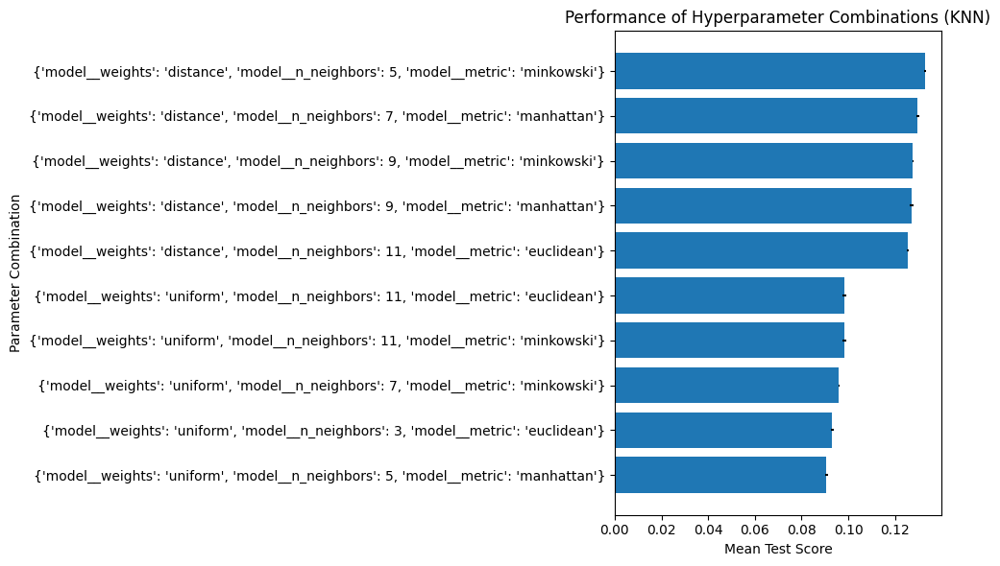

Best Hyperparameters: {'model__weights': 'distance', 'model__n_neighbors': 5, 'model__metric': 'minkowski'}
Best Accuracy Score: 0.13277141066844542


In [111]:
# Ekstrak hasil RandomizedSearchCV
results = pd.DataFrame(random_search.cv_results_)

# Urutkan hasil berdasarkan skor rata-rata
results = results.sort_values(by='mean_test_score', ascending=False)

# Tampilkan kombinasi parameter terbaik
print("Top 5 Hyperparameter Combinations:")
print(results[['mean_test_score', 'std_test_score', 'params']].head(5))

# Visualisasi Mean Test Scores
plt.figure(figsize=(10, 6))
plt.barh(
    results['params'].apply(str),
    results['mean_test_score'],
    xerr=results['std_test_score'],
    align='center'
)
plt.xlabel('Mean Test Score')
plt.ylabel('Parameter Combination')
plt.title('Performance of Hyperparameter Combinations (KNN)')
plt.gca().invert_yaxis()  # Kombinasi terbaik di bagian atas
plt.tight_layout()
plt.show()

# Laporan parameter terbaik
print("Best Hyperparameters:", random_search.best_params_)
print("Best Accuracy Score:", random_search.best_score_)

Efisiensi Hypertuning dengan RandomizedSearchCV:

Keuntungan:
* Tuning lebih cepat karena hanya mencoba subset parameter yang acak, ideal untuk ruang parameter besar.
Keterbatasan:
* Karena sifatnya acak, tidak semua kombinasi terbaik mungkin ditemukan.
Downsampling untuk Percepatan:

Menggunakan 40% data mempercepat proses tuning, tetapi:
* Risiko: Distribusi target dalam subset mungkin tidak mencerminkan data asli, yang bisa mengurangi generalisasi model.
* Solusi: Gunakan stratifikasi jika target tidak seimbang untuk mempertahankan distribusi target.

Performansi Model:
* Akurasi yang rendah (0.1328) menunjukkan bahwa Decision Tree mungkin bukan model terbaik untuk dataset ini.
* Model ini mungkin terlalu sederhana untuk menangkap pola kompleks dalam data.

Parameter Penting untuk Decision Tree:
* max_depth: Mengontrol kedalaman maksimum pohon, mencegah overfitting pada data kecil.
* min_samples_split dan min_samples_leaf: Membantu menghindari pembagian berlebihan dan membuat model lebih generalisasi.
* Kriteria seperti gini atau entropy dapat memengaruhi kualitas pemisahan node.

## XGBoost

Prompt : berikan insight dan kesimpulan dari model regressi dengan hypertuning xgboost regressor

In [21]:
from sklearn.decomposition import PCA

# Reduksi dimensi dengan PCA
pca = PCA(n_components=30)  # Kurangi dimensi ke 30 fitur

# Pipeline baru
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('pca', pca),
    ('model', XGBRegressor(random_state=42))
])

Keuntungan Menggunakan XGBoost Regressor:

* Cocok untuk dataset yang besar dan kompleks.
* Ideal untuk masalah regresi di mana hubungan antar fitur tidak linier.
* Mendukung berbagai fungsi loss, memungkinkan penyesuaian lebih baik terhadap target.

Hyperparameter Penting untuk Tuning:
* n_estimators: Jumlah pohon dalam ensemble. Jumlah yang lebih besar dapat meningkatkan performa tetapi membutuhkan waktu pelatihan lebih lama.
* learning_rate: Tingkat pembelajaran yang rendah sering menghasilkan model yang lebih baik tetapi membutuhkan lebih banyak pohon (n_estimators).
* max_depth: Membatasi kedalaman pohon untuk mengontrol overfitting.
* subsample: Mengontrol proporsi data yang digunakan untuk setiap pohon, membantu mencegah overfitting.
* colsample_bytree: Mengontrol proporsi fitur yang digunakan untuk membangun setiap pohon.

Kapan XGBoost Kurang Optimal:
* Untuk dataset kecil atau dataset dengan banyak noise, XGBoost mungkin overfit jika hyperparameter tidak diatur dengan baik.
* Untuk masalah sederhana atau dataset kecil, model yang lebih sederhana seperti Linear Regression mungkin lebih efektif.

Tantangan dalam Hypertuning:
* Ruang parameter yang luas membuat tuning membutuhkan banyak waktu komputasi. Oleh karena itu, RandomizedSearchCV atau Bayesian Optimization sering digunakan untuk mempercepat proses.

In [22]:
# Definisikan parameter grid untuk XGBoost Regressor
param_distributions = {
    'model__n_estimators': [50, 100, 200],  # Jumlah pohon
    'model__learning_rate': [0.01, 0.1, 0.2],  # Tingkat pembelajaran
    'model__max_depth': [3, 5, 7],  # Kedalaman maksimum pohon
    'model__subsample': [0.6, 0.8, 1.0],  # Subsampling untuk setiap pohon
    'model__colsample_bytree': [0.6, 0.8, 1.0],  # Subsampling fitur untuk setiap pohon
    'model__reg_alpha': [0, 0.1, 0.5],  # Regularisasi L1
    'model__reg_lambda': [1, 5, 10]  # Regularisasi L2
}

Penjelasan Parameter Grid
* model__n_estimators : Jumlah pohon dalam ensemble.Semakin banyak pohon, semakin kompleks model, sehingga dapat menangkap pola lebih baik.
* model__learning_rate : Kecepatan pembelajaran untuk memperbarui bobot dalam boosting. Untuk mengontrol seberapa besar kontribusi setiap pohon terhadap prediksi akhir.
* model__max_depth : Kedalaman maksimum pohon. Untuk Mengontrol kompleksitas setiap pohon dalam ensemble.
* model__subsample : Proporsi data sampel yang digunakan untuk setiap pohon. Membantu mencegah overfitting dengan menggunakan subset data secara acak.
* model__colsample_bytree : Proporsi fitur yang digunakan untuk setiap pohon. Membatasi fitur yang dipilih, membantu mencegah overfitting.
* model__reg_alpha : Regularisasi L1 (Lasso) untuk menekan bobot fitur yang kurang penting. Membantu mengurangi kompleksitas model dengan membuat beberapa bobot menjadi nol.
* model__reg_lambda : Regularisasi L2 (Ridge) untuk mengontrol bobot fitur. Membantu mengurangi overfitting dengan membatasi magnitude bobot.

Insight

Fleksibilitas XGBoost:
* Kombinasi parameter seperti learning_rate, max_depth, dan n_estimators memberikan kontrol penuh untuk menyeimbangkan bias dan varians.
* Regularisasi L1 (reg_alpha) dan L2 (reg_lambda) membantu menangani dataset yang kompleks atau dengan banyak fitur yang kurang relevan.

Pentingnya Subsampling:
* subsample dan colsample_bytree membantu mencegah overfitting dengan menggunakan subset data dan fitur untuk setiap pohon, mirip dengan Random Forest.

Keseimbangan Bias-Varians:
* Hyperparameter seperti max_depth dan n_estimators berperan besar dalam mengontrol bias-varians:
    * Nilai kecil cocok untuk dataset sederhana.
    * Nilai besar cocok untuk dataset kompleks tetapi membutuhkan regularisasi yang kuat.


In [23]:
# RandomizedSearchCV untuk XGBRegressor
random_search = RandomizedSearchCV(
    pipeline,
    param_distributions=param_distributions,
    n_iter=10,  # Jumlah kombinasi acak
    cv=3,  # Cross-validation folds
    scoring='neg_mean_squared_error',  # Gunakan MSE sebagai metrik evaluasi
    n_jobs=-1,  # Gunakan semua core CPU yang tersedia
    verbose=1,
    random_state=42
)

RandomizedSearchCV untuk Hyperparameter Tuning:
* Tujuan: Untuk mencari kombinasi hyperparameter optimal bagi model XGBRegressor dalam pipeline menggunakan teknik pencarian acak.

Kelebihan RandomizedSearchCV:
* Lebih cepat daripada GridSearchCV karena hanya mengevaluasi 10 kombinasi acak dari parameter grid (n_iter=10).
* Efisien untuk ruang parameter besar karena fokus pada subset kombinasi parameter.

Cross-Validation (cv=3):
* Data training dibagi menjadi 3 fold untuk mengevaluasi setiap kombinasi hyperparameter.
* Memastikan model diuji dengan data yang berbeda di setiap iterasi, sehingga menghasilkan evaluasi performa yang lebih stabil dan akurat.

Penggunaan Semua Core CPU (n_jobs=-1): 
* Memanfaatkan semua core CPU yang tersedia untuk paralelisasi proses, mempercepat pencarian hyperparameter.

Reproduktivitas Hasil (random_state=42):
* Menjaga konsistensi hasil dengan seed random yang sama, sehingga eksperimen dapat direplikasi.

Verbose: 
* Dengan verbose=1, proses tuning akan mencetak log progres, memungkinkan pemantauan jumlah kombinasi yang telah dievaluasi.

Insight : 
* Untuk regresi, metrik seperti MSE, MAE, atau R² lebih relevan dibandingkan completeness_score (yang dirancang untuk clustering). Gunakan:
    * MSE: Sensitif terhadap outlier karena menghitung error kuadrat.
    * MAE: Memberikan gambaran error absolut rata-rata, lebih robust terhadap outlier.
    * R²: Mengukur proporsi variabilitas target yang dapat dijelaskan oleh model.
* Parameter grid yang digunakan harus mencakup kombinasi yang mengontrol kompleksitas model (max_depth, n_estimators) dan regularisasi (reg_alpha, reg_lambda) untuk mencegah overfitting.

In [24]:
# Split data untuk downsampling
X_downsample, _, y_downsample, _ = train_test_split(
    X_train, y_train, test_size=0.4, random_state=42
)

In [25]:
# Fit model dengan data yang telah didownsample
random_search.fit(X_downsample, y_downsample)

Fitting 3 folds for each of 10 candidates, totalling 30 fits


RandomizedSearchCV(cv=3,
                   estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                             ('pca', PCA(n_components=30)),
                                             ('model',
                                              XGBRegressor(base_score=None,
                                                           booster=None,
                                                           callbacks=None,
                                                           colsample_bylevel=None,
                                                           colsample_bynode=None,
                                                           colsample_bytree=None,
                                                           device=None,
                                                           early_stopping_rounds=None,
                                                           enable_categorical=False,
                                                           eval_metric=None,
                                                           feature_types=None,
                                                           gamma=None...
                                                           num_parallel_tree=None,
                                                           random_state=42, ...))]),
                   n_jobs=-1,
                   param_distributions={'model__colsample_bytree': [0.6, 0.8,
                                                                    1.0],
                                        'model__learning_rate': [0.01, 0.1,
                                                                 0.2],
                                        'model__max_depth': [3, 5, 7],
                                        'model__n_estimators': [50, 100, 200],
                                        'model__reg_alpha': [0, 0.1, 0.5],
                                        'model__reg_lambda': [1, 5, 10],
                                        'model__subsample': [0.6, 0.8, 1.0]},
                   random_state=42, scoring='neg_mean_squared_error',
                   verbose=1)

Top 5 Hyperparameter Combinations:
   mean_test_score  std_test_score  \
6        94.909565        0.821106   
2        96.297835        0.744500   
3        97.527304        0.669477   
1        97.667879        0.713602   
5        98.462290        0.704929   

                                              params  
6  {'model__subsample': 0.8, 'model__reg_lambda':...  
2  {'model__subsample': 1.0, 'model__reg_lambda':...  
3  {'model__subsample': 0.6, 'model__reg_lambda':...  
1  {'model__subsample': 0.8, 'model__reg_lambda':...  
5  {'model__subsample': 0.6, 'model__reg_lambda':...  


C:\Users\NITRO 5\AppData\Local\Temp\ipykernel_23084\1832994581.py:27: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


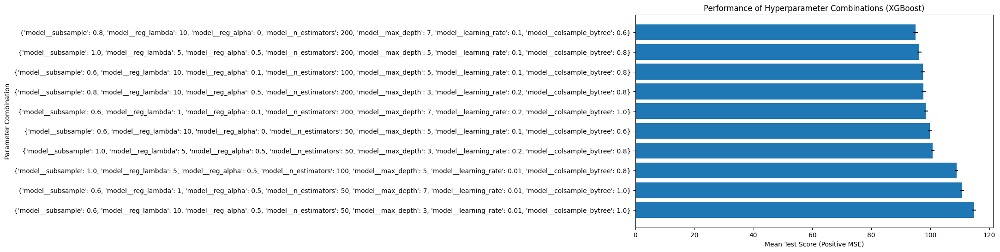

Best Hyperparameters: {'model__subsample': 0.8, 'model__reg_lambda': 10, 'model__reg_alpha': 0, 'model__n_estimators': 200, 'model__max_depth': 7, 'model__learning_rate': 0.1, 'model__colsample_bytree': 0.6}
Best Mean Squared Error (Positive): 94.90956457696798


In [27]:
# Ekstrak hasil RandomizedSearchCV
results = pd.DataFrame(random_search.cv_results_)

# Konversi skor negatif menjadi positif untuk interpretasi intuitif
results['mean_test_score'] = -results['mean_test_score']
results['std_test_score'] = results['std_test_score']

# Urutkan hasil berdasarkan skor rata-rata (positif sekarang)
results = results.sort_values(by='mean_test_score', ascending=True)

# Tampilkan kombinasi parameter terbaik (dengan skor positif)
print("Top 5 Hyperparameter Combinations:")
print(results[['mean_test_score', 'std_test_score', 'params']].head(5))

# Visualisasi Mean Test Scores dengan nilai positif
plt.figure(figsize=(10, 6))
plt.barh(
    results['params'].apply(str),
    results['mean_test_score'],
    xerr=results['std_test_score'],
    align='center'
)
plt.xlabel('Mean Test Score (Positive MSE)')
plt.ylabel('Parameter Combination')
plt.title('Performance of Hyperparameter Combinations (XGBoost)')
plt.gca().invert_yaxis()  # Kombinasi terbaik di bagian atas
plt.tight_layout()
plt.show()

# Laporan parameter terbaik dengan skor positif
best_score_positive = -random_search.best_score_
print("Best Hyperparameters:", random_search.best_params_)
print("Best Mean Squared Error (Positive):", best_score_positive)


Model Performance:

* Mean Squared Error (MSE):
94.91 (positive MSE) adalah nilai terbaik yang dihasilkan model pada data validasi.
Nilai ini menunjukkan error rata-rata kuadrat antara prediksi dan nilai sebenarnya, yang cukup kecil dalam konteks regresi.

* Distribusi Hyperparameter:
Grafik menunjukkan bahwa kombinasi dengan subsample=0.8 dan colsample_bytree=0.6 konsisten memberikan skor terbaik.
Kombinasi hyperparameter lainnya memiliki performa sedikit lebih buruk, dengan MSE positif yang lebih tinggi (lebih buruk).
Standard Deviation (std_test_score):

* Standar deviasi skor kecil (~0.7-0.8) menunjukkan bahwa hasil model cukup stabil selama cross-validation.

Model yang Teroptimasi:

* Hyperparameter tuning berhasil menemukan kombinasi optimal, menghasilkan error rata-rata kuadrat positif terbaik (MSE = 94.91).

Pengaruh Regularisasi dan Subsampling:
* reg_lambda=10 dan subsample=0.8 membantu mengontrol overfitting, menghasilkan model yang lebih generalisasi pada data validasi.
